# Myeloid cell integration and annotation using scVI, and Decipher trajectory analysis <a class="tocSkip">

Load and integrate myeloid cells across patients using scVI. Perform clustering and annotation. Finally, train Decipher and perform downstream analysis including basis decomposition and disruption score calculation to identify dysregulated transcriptional programs leading to M1 vs. M2-like polarization

Author: Kevin Hoffer-Hawlik (Azizi)

## Setup

In [1]:
import warnings
import pandas as pd
import numpy as np
import anndata as ad
import scanpy as sc
import matplotlib.pyplot as plt
import scvi
import seaborn as sns
import scipy.stats
import pickle
import seaborn as sns
import decipher as dc

/home/kh3205/anaconda3/envs/decipher/lib/python3.11/site-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/home/kh3205/anaconda3/envs/decipher/lib/python3.11/site-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (
/home/kh3205/anaconda3/envs/decipher/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
warnings.simplefilter(action='ignore',)

In [3]:
warnings.simplefilter(action='ignore',)

## Load data and set global settings

In [4]:
clinical_outcomes = pd.read_csv("clin_022625.csv")
clinical_outcomes.set_index(keys = 'sample', inplace=True)

In [5]:
myeloid_signatures = pd.read_csv('myeloid_signatures.csv')
myeloid_signatures_list = list(myeloid_signatures.columns[:-11])
for i, s in enumerate(myeloid_signatures_list): # for compatibility with input ad
    myeloid_signatures_list[i] = s + "1"

In [6]:
LT_myeloid_signatures = pd.read_excel('Cell_Type_Markers_Myeloid.xlsx')
LT_myeloid_signatures = LT_myeloid_signatures.to_dict('list')
LT_myeloid_signatures_list = list(LT_myeloid_signatures.keys())
for sig in LT_myeloid_signatures_list: 
    LT_myeloid_signatures[sig] = [x for x in LT_myeloid_signatures[sig] if str(x) != 'nan']
#set(myeloid_signatures.loc[:,'Monocytes'].dropna()) & set(ad.var_names)

# myeloid scVI integration

In [6]:
myeloid = sc.read_h5ad('myeloid_processed_012224.h5ad')
myeloid.shape

(18152, 2041)

In [7]:
np.max(myeloid.raw.X) # double check raw exists

1417.0

In [6]:
scvi.model.SCVI.setup_anndata(myeloid, layer = "counts", batch_key = "patient")

In [ ]:
# create model (default with two hidden layers for encoder/decoder NNs and latent dimensionality of 30)
vae = scvi.model.SCVI(myeloid, n_layers=2, n_latent=30)
vae.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 61/400:  15%|█      | 60/400 [03:23<18:41,  3.30s/it, v_num=1, train_loss_step=400, train_loss_epoch=441]

In [ ]:
myeloid.obsm["X_scVI"] = vae.get_latent_representation()

In [ ]:
# calculate new neighborhood graph and UMAP dim reduction (after batch correction)
sc.pp.neighbors(myeloid, use_rep="X_scVI", n_neighbors = 20)
sc.tl.umap(myeloid)

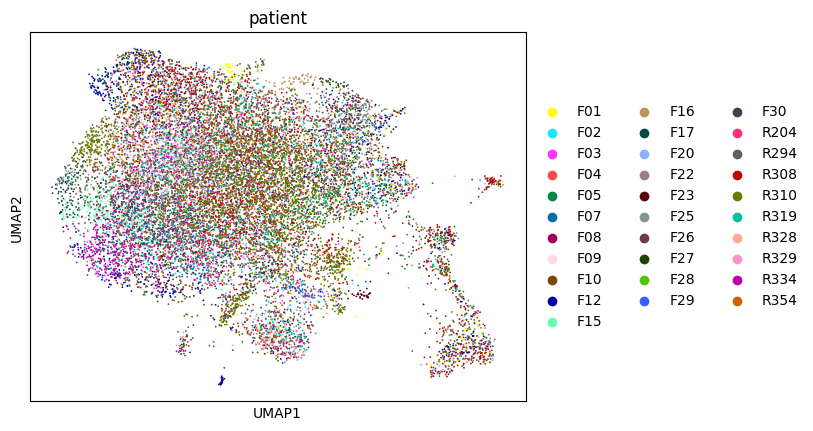

In [21]:
sc.pl.umap(myeloid, color='patient')

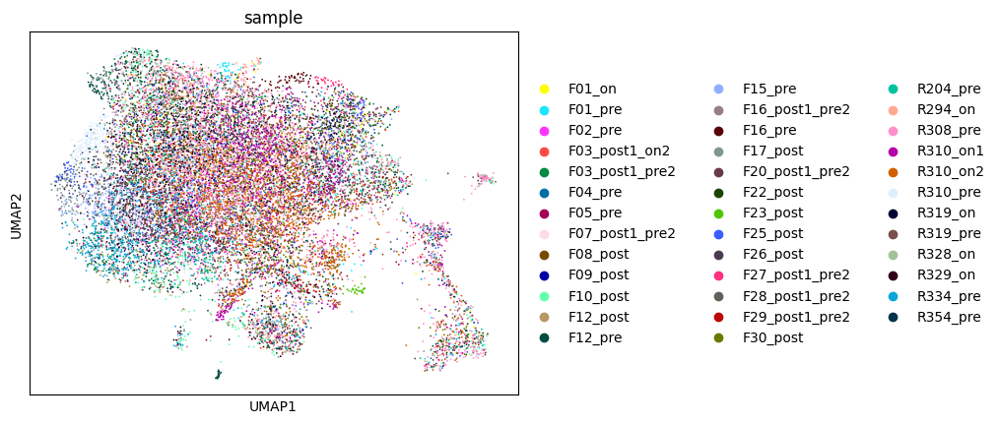

In [22]:
sc.pl.umap(myeloid, color='sample')

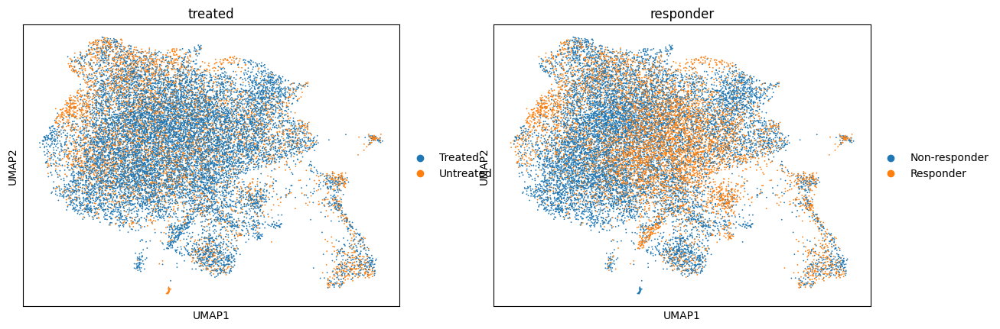

In [23]:
sc.pl.umap(myeloid, color=['treated','responder'])

In [20]:
myeloid.write_h5ad('myeloid_scvi_031225.h5ad')

# perform annotations using scVI batch corrected space

In [19]:
myeloid = sc.read_h5ad('myeloid_scvi_031225.h5ad')

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.37550926208496094 seconds
Jaccard graph constructed in 16.78021264076233 seconds
Wrote graph to binary file in 0.25554585456848145 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.743102
After 3 runs, maximum modularity is Q = 0.745255
Louvain completed 23 runs in 9.208187341690063 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 40.7732310295105 seconds


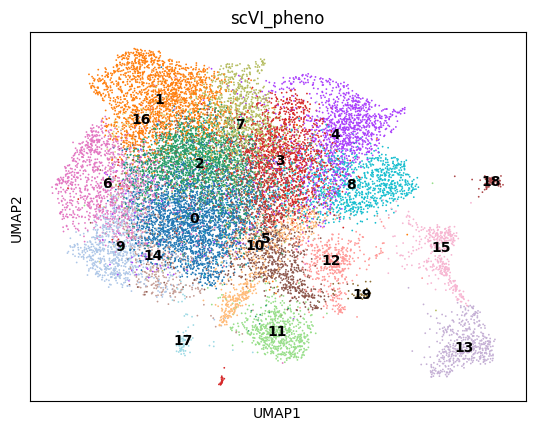

In [30]:
k=30; res = 1.0
communities, graph, Q = sc.external.tl.phenograph(myeloid.obsm['X_scVI'], k = k, resolution_parameter = res)
myeloid.obs['scVI_pheno'] = pd.Categorical(communities)
myeloid.uns['scVI_pheno_Q'] = Q
sc.pl.umap(myeloid, color='scVI_pheno', legend_loc="on data")

In [35]:
myeloid.uns["log1p"]["base"] = None # needed if loading anndata (r/w error in scanpy)
sc.tl.rank_genes_groups(myeloid, groupby='scVI_pheno', layer = 'normalized_counts', use_raw=False, method='t-test', key_added = "t-test")
deg_df = sc.get.rank_genes_groups_df(myeloid, group=None, key='t-test').sort_values(["scores"],ascending=False)
deg_df.to_csv('myeloid_degs_032025.csv')

In [ ]:
for key in [
 'MG_enriched_bowman',
 'core_microglia_bowman',
 'Core_MG_bowman',
 'TAM_MG_bowman',
 'TAM_microglia_bowman',
 'Microglia_Ben',
 'MG_Markers_muller',
 'BMDM_enriched_bowman',
 'TAM_BMDM_bowman',
 'Monocytes',
 'TAM_monocytes_bowman',
 'cd14_monocytes',
 'cd16_monocytes',
 'mono3',
 'mono4',
 'Macrophage_nuc',
 'Macrophages',
 'M1_macrophage_polarization',
 'M1_bi',
 'M1',
 'M1_cheng',
 'M1_ada',
 'M2_macrophage_polarization',
 'M2_bi',
 'M2',
 'M2_cheng',
 'M2_ada',
 'Dendritic_cell',
 'cDC',
 'cDC1',
 'cDC2',
 'pDC',
 'DC1_CD141.CLEC9A',
 'DC2_CD1C_A',
 'DC3_CD1C_B',
 'DC4',
 'DC5',
 'DC6_pDC',
 'Pro_inflammatory',
 'Anti_inflammatory',
 'Angiogenesis_cheng',
 'Phagocytosis_cheng',
 'DC3_zilionis',
 'pDC_zilionis',
 'monoDC_zilionis',
 'hMoMacDC_zilionis',
 'neutrophils_zilionis',
 'mast_cells_zilionis',
 'sankowski_c1_cytokine',
 'sankowski_c2_homeostatic',
 'sankowski_c3_homeostatic',
 'sankowski_c5_proinflammatory',
 'sankowski_c6_antigen_presenting',
 'sankowski_c7_antigen_presenting',
 'sankowski_c8_chemotaxis',
 'sankowski_c9_chemotaxis',
 'gueriero_antitumor',
 'gueriero_protumor',
]:
    plt.figure()
    sns.violinplot(myeloid.obs, x='scVI_pheno', y=key+'1')

In [ ]:
monocytes = ['Monocytes','cd14_monocytes','cd16_monocytes']
macrophages = ['Macrophages',]
m1 = ['M1_ada',]
m2 = ['M2_ada',]
DCs = ['Dendritic_cell',]
cDC1 = ['cDC','cDC1',]
cDC2 = ['cDC','cDC2',]
DC3 = ['DC3_zilionis',]
phag =['Phagocytosis_cheng',]
AP = ['sankowski_c6_antigen_presenting','sankowski_c7_antigen_presenting',]
set(myeloid_signatures[phag].values.flatten())

{'C1QB', 'CD163', 'MERTK', 'MRC1', nan}

<Axes: xlabel='scVI_pheno', ylabel='Phagocytosis_cheng1'>

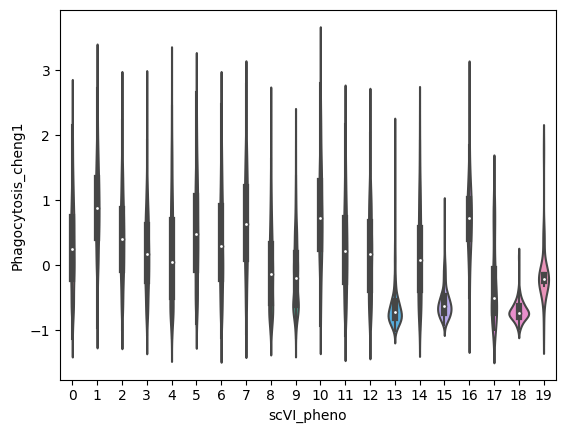

In [154]:
sns.violinplot(myeloid.obs, x='scVI_pheno', y='Phagocytosis_cheng1')

In [109]:
# myeloid.obs['scVI_pheno'].to_csv('myeloid_scVI_pheno_032025.csv')

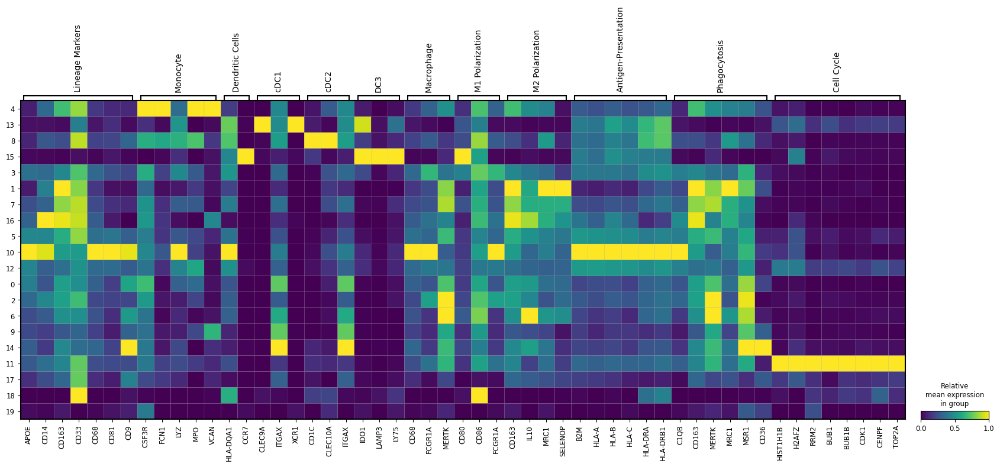

In [180]:
myeloid.obs['scVI_pheno_ordered'] = pd.Categorical(
    values=myeloid.obs['scVI_pheno'], 
    categories=[4, 13,8,15, 3, 1,7,16, 5,10,12, 0,2,6,9,14, 11, 17,18,19], 
    ordered=True
)

# markers = ['CD11A','CD68','MPO','CD11B','CD11C']
# markers = list( set(markers) & set(myeloid.var_names) )

markers = {
    'Lineage Markers': ['APOE', 'CD14', 'CD163', 'CD33', 'CD68', 'CD81', 'CD9'],
    'Monocyte': ['CSF3R', 'FCN1', 'LYZ', 'MPO', 'VCAN'],
    'Dendritic Cells': ['HLA-DQA1', 'CCR7'],
    'cDC1': ['CLEC9A', 'ITGAX', 'XCR1'],
    'cDC2': ['CD1C', 'CLEC10A', 'ITGAX'],
    'DC3': ['IDO1', 'LAMP3', 'LY75'],
    # 'Dendritic Cells': ['CLEC9A', 'FLT3', 'IDO1', 'HLA-DQA1', 'LAMP3', 'XCR1','CD1C','CLEC10A','LY75'], # includes specific markers for cDC1, cDC2, DC3. DC3 could include ['KIF2A','IL15','TRAF1','RFTN1','MGLL','BIRC3','STK4','NFKB1','CD83','UVRAG','CERS6','LY75'] but LY75 seems to be the most relevant
    'Macrophage': ['CD68', 'FCGR1A', 'MERTK'],
    'M1 Polarization': ['CD80', 'CD86', 'FCGR1A'],
    'M2 Polarization': ['CD163', 'IL10', 'MRC1', 'SELENOP'],
    'Antigen-Presentation': ['B2M', 'HLA-A','HLA-B','HLA-C','HLA-DRA', 'HLA-DRB1'],
    'Phagocytosis': ['C1QB', 'CD163', 'MERTK', 'MRC1','MSR1','CD36'],
    'Cell Cycle': ['HIST1H1B','H2AFZ','RRM2'] + ['BUB1','BUB1B','CDK1','CENPF','TOP2A'] #+ ['BRCA1','BRCA2'],
}
# sc.pl.dotplot(myeloid, var_names = markers, groupby='scVI_pheno', use_raw=False, 
#               standard_scale='var', colorbar_title='Relative\nmean expression\nin group',
#               save = 'markers_dot.pdf', show=False
#              )

sc.pl.matrixplot(myeloid, var_names = markers, groupby='scVI_pheno_ordered', use_raw=False, layer='normalized_counts',
                 standard_scale='var', 
                 colorbar_title='Relative\nmean expression\nin group',
                 # save = 'markers_matrix.pdf', show=False
                )

In [185]:
new_annotations = {
    4:'Monocyte', # monocytes      # CSF3R, FCN1, MPO, VCAN
    
    13:'cDC1', # cDC1          # CLEC9A, ITGAX, XCR1
    8:'cDC2', # cDC2           # CD1C, CLEC10A, ITGAX
    15:'DC3', # DC3           # IDO1, LAMP3, LY75

    3:'M1-like Macrophage', # M1-like        # CD80, CD86, FCGR1A, FPR2, IFIT2
    
    1:'M2-like Macrophage', # M2-like        # F13A1, CD163L1, CD163, IL10, MRC1, SELENOP
    7:'M2-like Macrophage', # M2-like        # CD163, MRC1, CD163L1, F13A1, IQGAP2, SELENOP
    16:'M2-like Macrophage', # M2-like       # F13A1, CD163, MRC1, RNASE1, CYP27A1, SELENOP
    
    5:'Antigen-presenting Macrophage', # AP             # B2M, HLA-A, HLA-B, HLA-C
    10:'Antigen-presenting Macrophage', # AP            # B2M, HLA-A, HLA-B, HLA-C
    12:'Antigen-presenting Macrophage', # AP            # B2M, HLA-A, HLA-B, HLA-C

    0:'Phagocytic Macrophage', # phago          # MERTK
    2:'Phagocytic Macrophage', # phago          # MERTK
    6:'Phagocytic Macrophage', # phago          # MERTK, MRC1
    9:'Phagocytic Macrophage', # phago          # MARCO, MSR1, CD36, PPARG (M2)
    14:'Phagocytic Macrophage', # phago         # CD68, MSR1, CD36, PPARG (M2), SIRPA, RAB7B
    
    11:'Cycling Myeloid', # Cycling (myeloid)       # see cell cycle genes

    17:'Osteoclast-like Cell', # Osteoclast-like Cells   # TNFRSF11A, MYO1D, MMP9, NFATC1
    18:'Langerhans Cell', # Langerhans Cells        # CD207 (!), HLA-DQA1, HLA-DQA1, HLA-DQB2 # langerhans cells
    19:'Microglial Cell', # Microglial Cells        # LRP1B, CNTNAP2, MACROD2, NRXN3  # also highly patient-specific
}

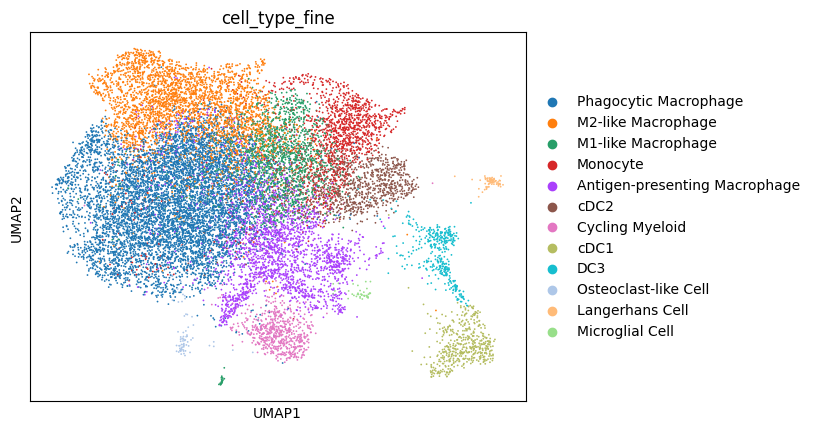

In [186]:
myeloid.obs['cell_type_fine'] = myeloid.obs['scVI_pheno'].replace(new_annotations)
sc.pl.umap(myeloid, color='cell_type_fine')

In [187]:
myeloid.write_h5ad('myeloid_scvi_annotated_032025.h5ad')

In [188]:
myeloid.obs['cell_type_fine'].to_csv('myeloid_scvi_annotations_032025.csv')

# re-run Decipher

In [7]:
myeloid = sc.read_h5ad('myeloid_scvi_annotated_032025.h5ad')

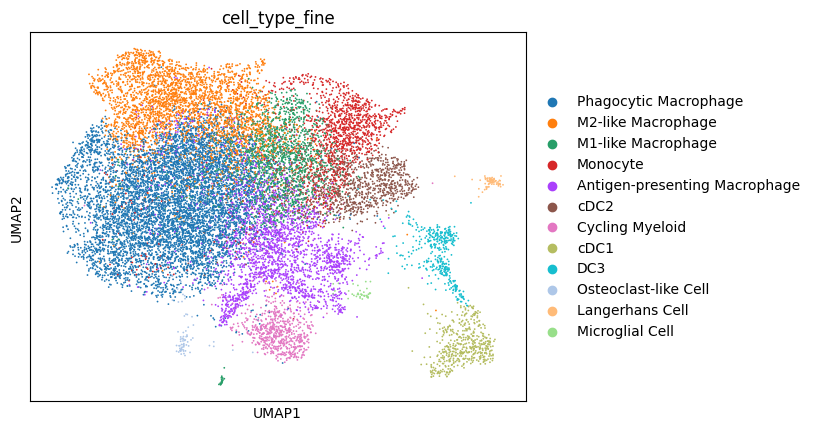

In [8]:
sc.pl.umap(myeloid, color='cell_type_fine')

In [9]:
# focus on monocyte to macrophage transition
adata = myeloid[myeloid.obs['cell_type_fine'].isin(
    ['Antigen-presenting Macrophage','Phagocytic Macrophage',
     'M2-like Macrophage','Monocyte','M1-like Macrophage',]
)]

In [ ]:
# optionally remove F26 outlier mucosal cells (saved separate trained models for comparison)
adata = adata[adata.obs['patient']!='F26']

(14587, 2041)
(14587, 2027)


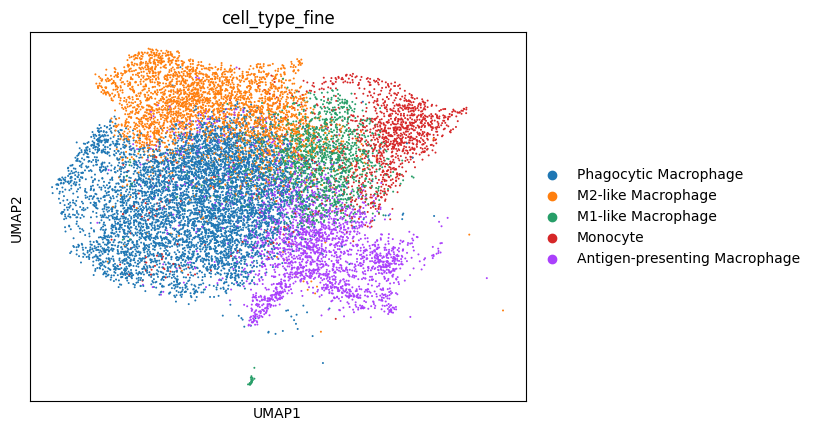

In [11]:
print(adata.shape)
sc.pp.filter_genes(adata, min_cells=3)
print(adata.shape)
sc.pl.umap(adata, color = 'cell_type_fine')

Epoch 33 | train elbo: 453.12 | val ll: 447.01:  54%|██████████████            | 33/61 [02:55<02:29,  5.32s/it]2025-04-02 15:18:16,912 | INFO : Added `.obsm['decipher_v']`: the Decipher v space.
2025-04-02 15:18:16,912 | INFO : Added `.obsm['decipher_z']`: the Decipher z space.
2025-04-02 15:18:16,929 | INFO : Saving decipher model with run_id 2025-04-02-15-18-16-critical-furious-candy.


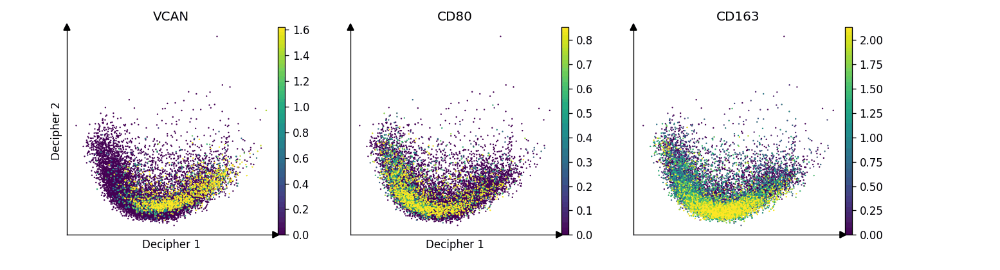

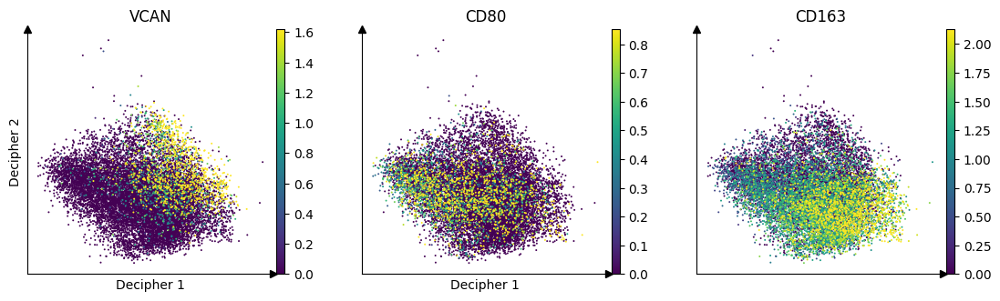

In [12]:
seed = 28
print(seed, 'seed')
config = dc.tl.DecipherConfig(
    dim_z=10,
    dim_v=2,
    layers_v_to_z=(256,), # default
    layers_z_to_x=[],
    seed=seed,
    beta=1e-1,
    learning_rate=5e-3, # default 5e-3
    n_epochs=61
)
model, losses = dc.tl.decipher_train(
    adata, config, plot_kwargs=dict(
    color=["VCAN","CD80","CD163"],
    vmax=lambda xs: np.quantile(xs, 0.95),
    ncols=3,
    layer = 'normalized_counts'
    ), plot_every_k_epochs=5
)

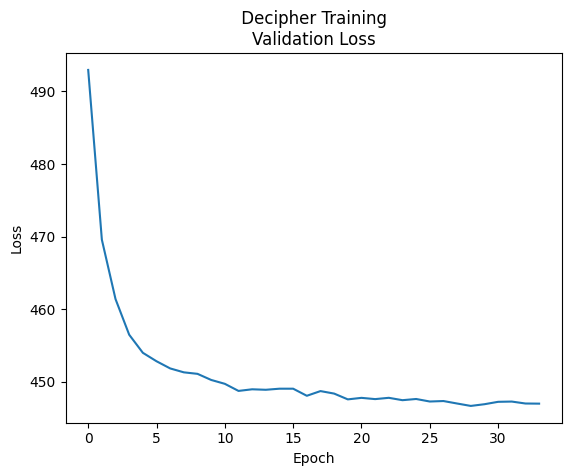

In [13]:
fig, ax = plt.subplots()
ax.plot(losses)
ax.set(xlabel="Epoch",ylabel="Loss",title=" Decipher Training \nValidation Loss");

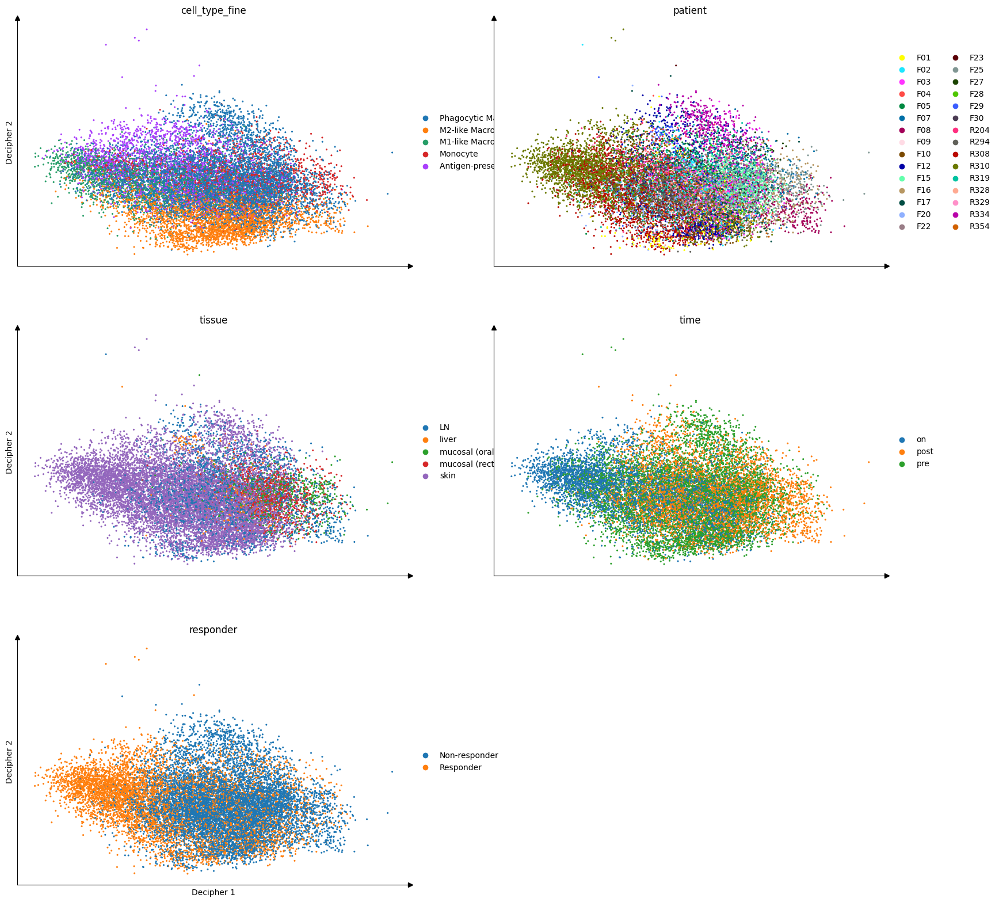

In [14]:
fig = dc.pl.decipher(adata, color = ['cell_type_fine','patient','tissue','time','responder'], figsize = (9,6), s=20)

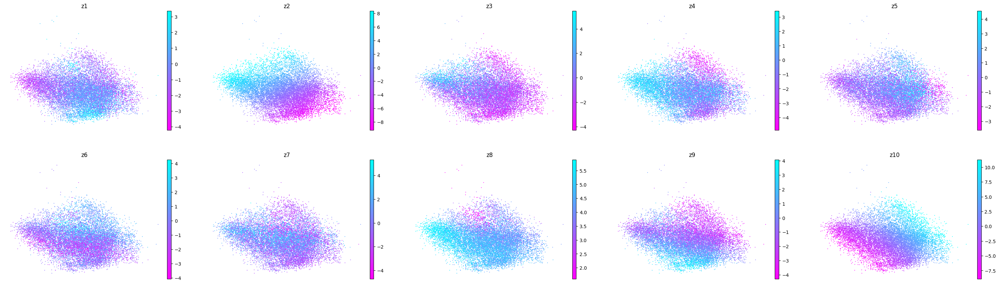

In [15]:
# plot all of decipher z dimensions
fig = dc.pl.decipher_z(adata, ncols=5)

In [ ]:
adata.write('myeloid_decipher_032125.h5ad') # all pts
adata.write('myeloid_decipher_040225.h5ad') # no F26

# refine visualization, construct trajectories

## edit outliers and visualize cells

In [20]:
# adata = sc.read_h5ad('myeloid_decipher_032125.h5ad') # all pts
# adata = sc.read_h5ad('myeloid_decipher_040225.h5ad') # no F26

In [21]:
# model = dc.tl.decipher_load_model(adata)

V5


In [ ]:
def edit_outliers(ad, outlier_direction, k, remove = True, plot=True):
    """
    Removes visual distortions that Decipher is prone to making by removing outlier cells.
    Take outlier in 'north', 'east', 'south', or 'west' direction and place closer to global structure. 
    k refers to placement: set k = -2 to move to second largest, or k = 1 for second smallest.
    Set remove parameter to true if desiring to remove datapoint.
    """
    ad = ad.copy()
    decipher_v = ad.obsm['decipher_v'] # first index is the cell, second index is decipher_v1 (0) or decipher_v2 (1)
    
    if outlier_direction == 'north':
        index = decipher_v[:,1].argmax() # largest value in decipher_v2 span
        fix_value = np.partition(decipher_v[:,1], k)[k] # second largest value
        ad.obsm['decipher_v'][index,1] = fix_value
    elif outlier_direction == 'east':
        index = decipher_v[:,0].argmax() # largest value in decipher_v1 span
        fix_value = np.partition(decipher_v[:,0], k)[k] # second largest value
        ad.obsm['decipher_v'][index,0] = fix_value
    elif outlier_direction == 'south':
        index = decipher_v[:,1].argmin() # smallest value in decipher_v2 span
        fix_value = np.partition(decipher_v[:,1], k)[k] # second smallest value
        ad.obsm['decipher_v'][index,1] = fix_value
    elif outlier_direction == 'west':
        index = decipher_v[:,0].argmin() # smallest value in decipher_v1 span
        fix_value = np.partition(decipher_v[:,0], k)[k] # second smallest value
        ad.obsm['decipher_v'][index,0] = fix_value
        
    if remove:
        mask = np.full((ad.shape[0],),True)
        mask[index] = False
        ad = ad[mask,:]
    
    if plot:
        sc.pl.embedding(ad, basis='decipher_v')
    return ad
        
adata = edit_outliers(adata, outlier_direction = 'north', k = 1, remove=True)
adata = edit_outliers(adata, outlier_direction = 'north', k = 1, remove=True)
adata = edit_outliers(adata, outlier_direction = 'north', k = 1, remove=True)
adata = edit_outliers(adata, outlier_direction = 'north', k = 1, remove=True)

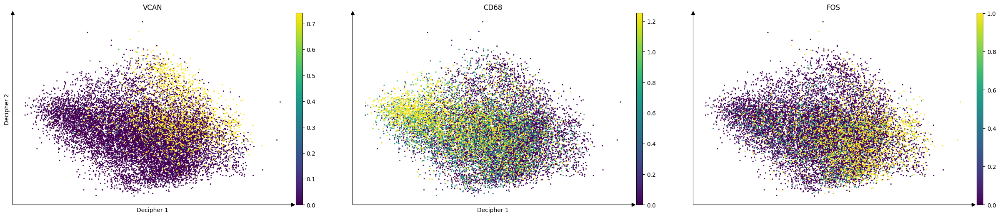

In [18]:
fig = dc.pl.decipher(adata, color = ['VCAN','CD68','FOS'], figsize = (9,6), s=20, ncols=3,
                     layer = 'normalized_counts', vmin='p10', vmax='p90')

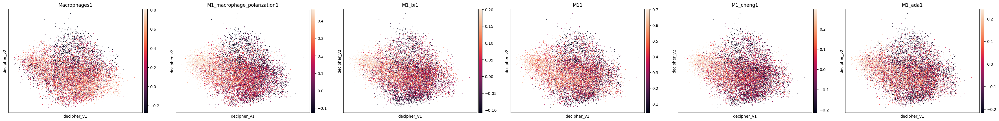

In [19]:
# M1 signatures
sc.pl.embedding(adata, basis='decipher_v', color = [
 'Macrophages1',
 'M1_macrophage_polarization1',
 'M1_bi1',
 'M11',
 'M1_cheng1',
 'M1_ada1',
], ncols=8, vmin='p10',vmax='p90', cmap = 'rocket')

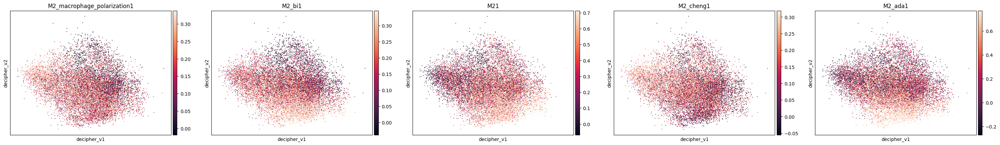

In [20]:
# M2 signatures
sc.pl.embedding(adata, basis='decipher_v', color = [
 'M2_macrophage_polarization1',
 'M2_bi1',
 'M21',
 'M2_cheng1',
 'M2_ada1',
], ncols=8, vmin='p10',vmax='p90', cmap = 'rocket')

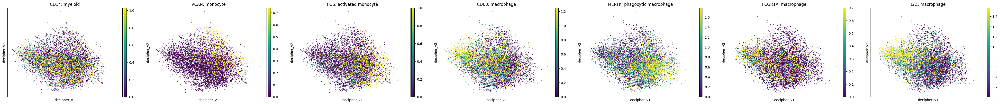

In [ ]:
# specific markers:
sc.pl.embedding(adata, basis = 'decipher_v', vmax='p90', ncols=7, layer='normalized_counts', 
          color = ['CD14', 'VCAN', 'FOS', 'CD68', 'MERTK', 'FCGR1A', 'LYZ'], 
          title = ['CD14: myeloid','VCAN: monocyte','FOS: activated monocyte','CD68: macrophage','MERTK: phagocytic macrophage','FCGR1A: macrophage','LYZ: macrophage']
          )

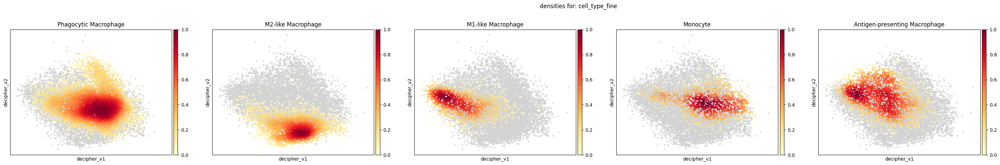

In [22]:
obs = 'cell_type_fine'
adata.obsm['X_decipher_v'] = adata.obsm['decipher_v'].copy() # implementation issue with embedding density
sc.tl.embedding_density(adata, basis='decipher_v', groupby = obs)
fig = sc.pl.embedding_density(adata, basis='decipher_v', key = 'decipher_v_density_'+obs,
                              bg_dotsize = 40, fg_dotsize = 40, ncols=5, return_fig=True)
fig.suptitle('densities for: '+obs, y=1.06);

## explore decipher V space

In [29]:
# adata = sc.read_h5ad('myeloid_decipher_032125.h5ad')

In [30]:
# model = dc.tl.decipher_load_model(adata)

### make rotations

In [23]:
# ideally want monocyte to macrophage transition captured in in Decipher 1
replace = {'Monocyte'  : 0,
           'M1-like Macrophage' : 1,
           'M2-like Macrophage' : 1,
           'Antigen-presenting Macrophage' : 1,
           'Phagocytic Macrophage' : 1,}
adata.obs['mono_vs_macro'] = adata.obs['cell_type_fine'].replace(replace)

2025-04-02 16:13:58,824 | INFO : Added `.obsm['decipher_v']`: the Decipher v space.
2025-04-02 16:13:58,824 | INFO : Added `.obsm['decipher_z']`: the Decipher z space.


V5


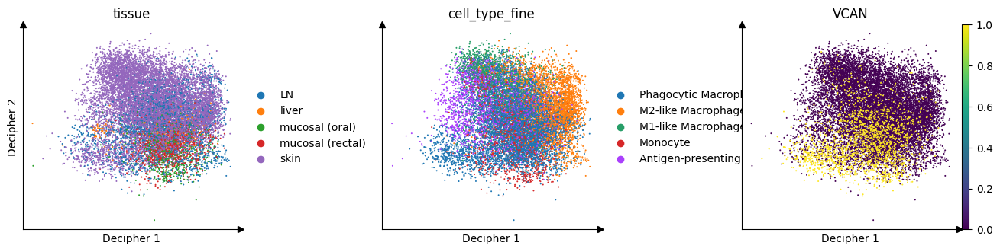

In [24]:
dc.tl.decipher_rotate_space(
    adata,
    v1_col = 'mono_vs_macro', # v1_order = [] ,# list annotations in order
    v2_col = 'mono_vs_macro', # v2_order = None # since binary,
)
fig2 = dc.pl.decipher(adata, ['tissue','cell_type_fine','VCAN',], wspace=.5, ncols=5, vmax='p90')

In [ ]:
# adata.write('myeloid_decipher_rotated_032125.h5ad') # all patients
adata.write('myeloid_decipher_rotated_040225.h5ad') # no F26 patient

## Trajectory analysis

### examine marker genes for trajectories

In [ ]:
examine_list = ['LAMP3','CLEC9A','IDO1','CCL19','XCR1','CCR7','CCL17']
examine_list = list(set(examine_list) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

In [ ]:
examine_list = ['ITGAX', 'MMP19', 'VEGFA', 'CD14', 'LYZ', 'CD68', 'CTSA', 'CTSB', 'CTSC', 'CTSD','IDO1','LAMP3']
examine_list = list(set(examine_list) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

In [ ]:
# monocyte signature genes
examine_list = list(set(myeloid_signatures.loc[:,'Monocytes'].values) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

In [ ]:
# M1 signature genes
examine_list = list(set(myeloid_signatures.loc[:,'M1_ada'].values) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

In [ ]:
# M1 signature genes
examine_list = list(set(myeloid_signatures.loc[:,'M1_macrophage_polarization'].values) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

In [ ]:
# M2 signature genes
examine_list = list(set(myeloid_signatures.loc[:,'M2_ada'].values) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

In [ ]:
# M2 signature genes
examine_list = list(set(myeloid_signatures.loc[:,'M2_macrophage_polarization'].values) & set(adata.var_names))
fig3 = dc.pl.decipher(adata, color=examine_list, layer='normalized_counts', vmin='p10',vmax='p90', ncols=10)

### construct trajectories

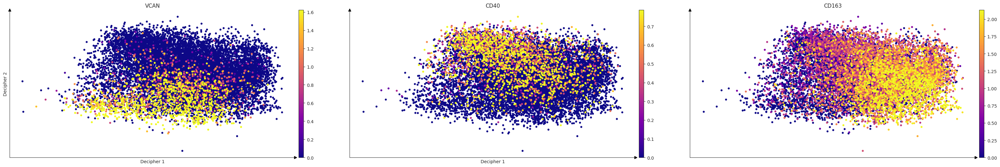

In [93]:
fig = dc.pl.decipher(adata, color = ['VCAN','CD40','CD163'], figsize = (12,6), s=80, layer='normalized_counts', vmin='p05',vmax='p95', ncols=3, cmap='plasma')

In [26]:
dc.tl.cell_clusters(adata,
                    leiden_resolution = 2.0, # default 1.0
                    n_neighbors = 10, # default 10
                    seed = 0, # default 0
                   )

2025-04-02 16:14:31,859 | INFO : Clustering cells using scanpy Leiden algorithm.
2025-04-02 16:14:31,860 | INFO : Step 1: Computing neighbors with `sc.pp.neighbors`, with the representation decipher_z.
2025-04-02 16:14:53,576 | INFO : Step 2: Computing clusters with `sc.tl.leiden`, and resolution 2.0.
2025-04-02 16:15:00,484 | INFO : Added `.obs['decipher_clusters']`: the cluster labels.


2025-04-02 19:58:31,726 | INFO : Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2025-04-02 19:58:31,732 | INFO : Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


<Axes: xlabel='decipher_clusters', ylabel='Count'>

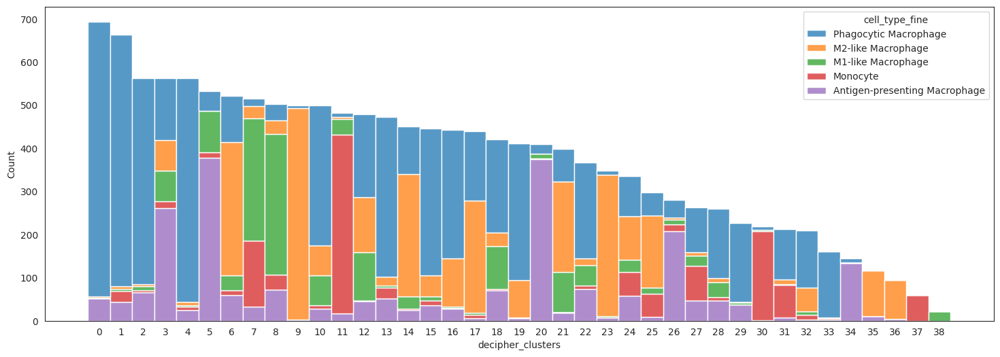

In [94]:
plt.figure(figsize=(18,6))
sns.histplot(adata.obs, x='decipher_clusters', hue='cell_type_fine', multiple='stack')

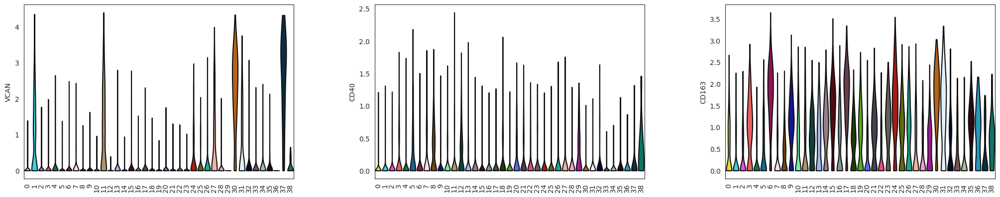

In [95]:
# sns.violinplot(sc.get.obs_df(adata, keys=['VCAN','CD40','CD163','decipher_clusters']), x='decipher_clusters', y='VCAN')
# sns.violinplot(sc.get.obs_df(adata, keys=['VCAN','CD40','CD163','decipher_clusters']), x='decipher_clusters', y='CD40')
# sns.violinplot(sc.get.obs_df(adata, keys=['VCAN','CD40','CD163','decipher_clusters']), x='decipher_clusters', y='CD163')
sc.pl.violin(adata, ['VCAN','CD40','CD163'], groupby='decipher_clusters', layer='normalized_counts', use_raw=False, stripplot=False, rotation=90)

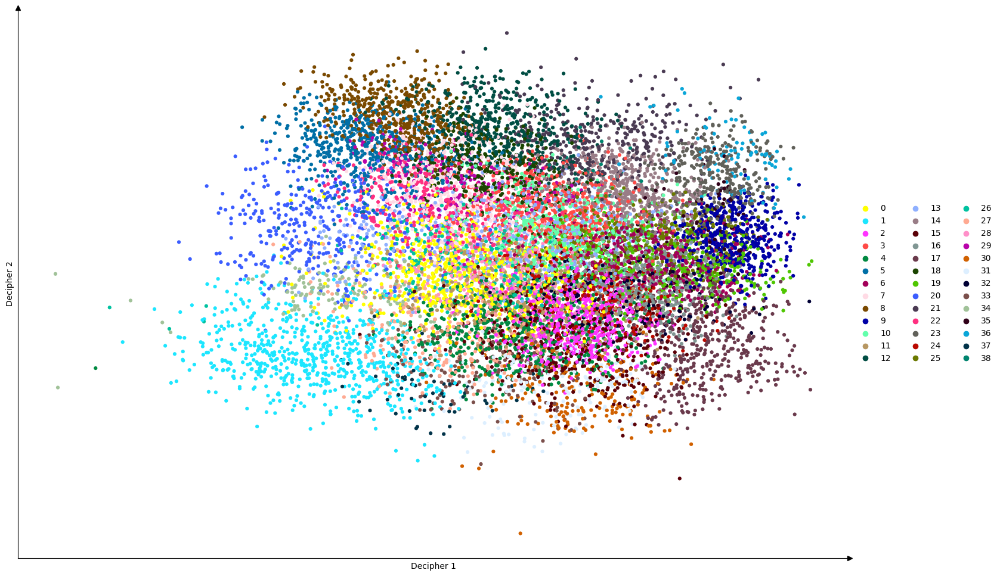

In [28]:
fig = dc.pl.decipher(adata, color = ['decipher_clusters'], figsize = (18,12), s=80, 
                     # legend_loc = 'on data',
                    )

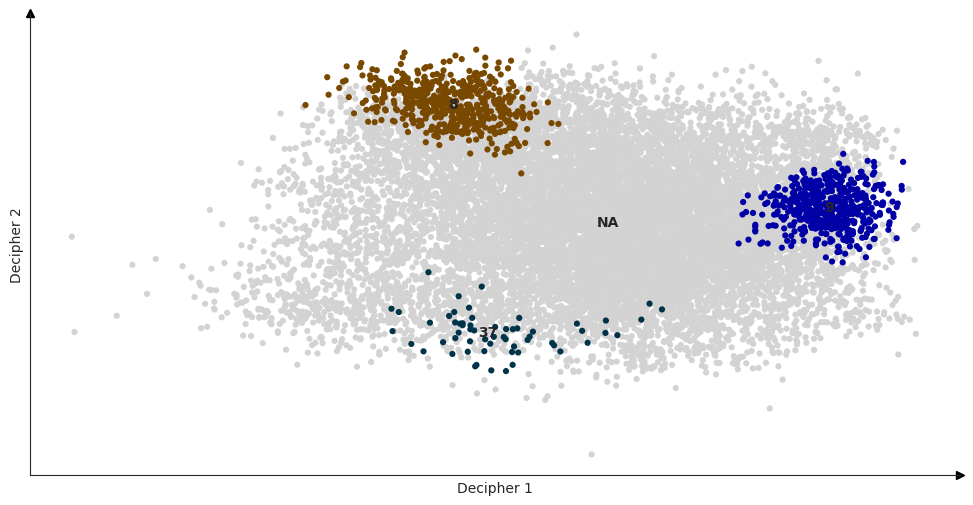

In [ ]:
# groups = {22 : M2, 2 : M1, 29 : monocyte} # 032125 (all patients)
# groups = {9 : M2, 8 : M1, 37 : monocyte} # 040225 (no F26 patient)
fig = dc.pl.decipher(adata, color = ['decipher_clusters'], figsize = (12,6), s=80, groups=['37','9','8'], legend_loc='on data') # 

2025-04-02 19:59:10,998 | INFO : Trajectory Monocyte-M1 : ['37', '33', '4', '11', '28', '13', '10', '3', '18', '29', '7', '5', '8'])
2025-04-02 19:59:11,003 | INFO : Added trajectory Monocyte-M1 to `adata.uns['decipher']['trajectories']`.
2025-04-02 19:59:11,012 | INFO : Trajectory Monocyte-M2 : ['37', '33', '4', '15', '2', '24', '32', '16', '6', '25', '35', '9'])
2025-04-02 19:59:11,017 | INFO : Added trajectory Monocyte-M2 to `adata.uns['decipher']['trajectories']`.


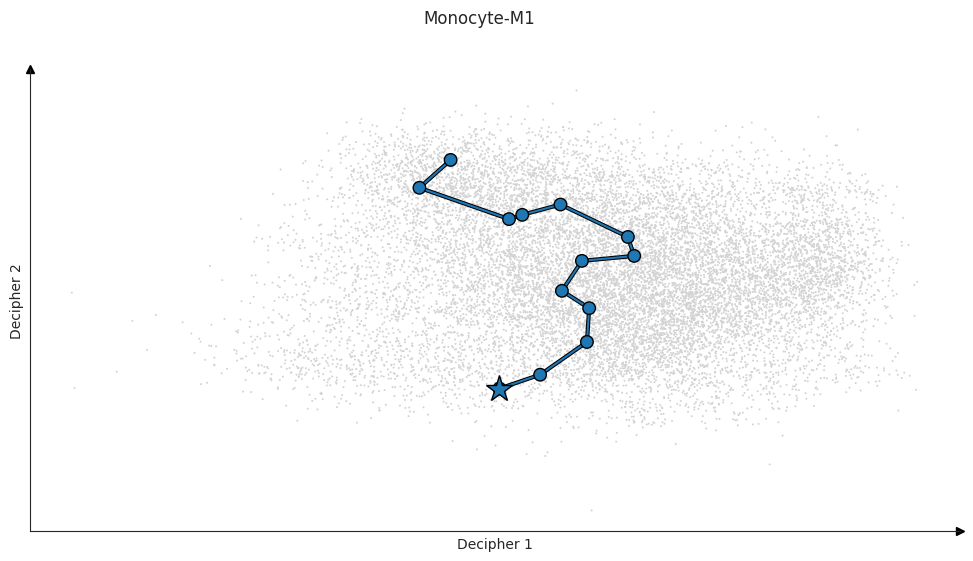

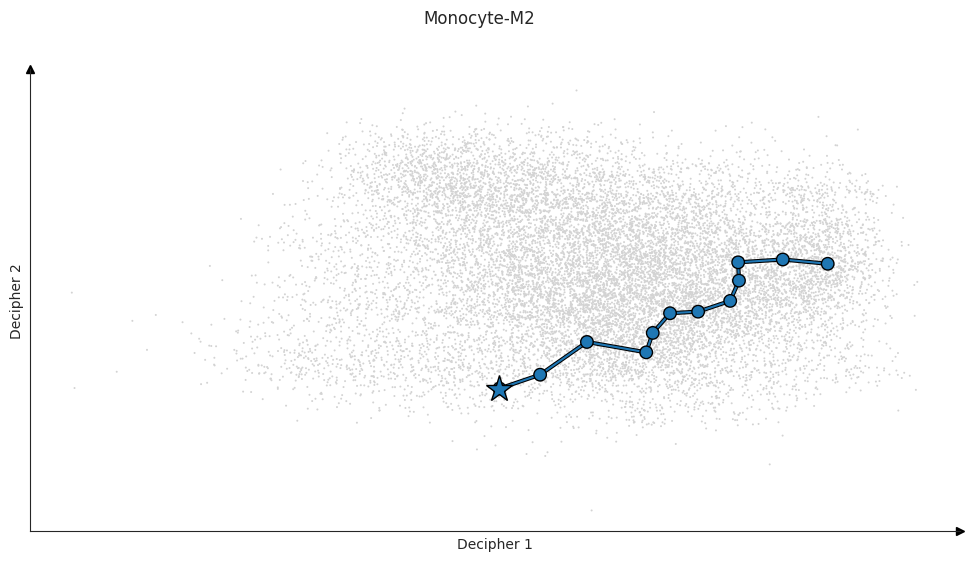

In [ ]:
# monocyte = VCAN cluster 29, M1 = CD40 cluster 2, M2 = CD163 cluster 22 # 032125 (all patients)
# monocyte = VCAN cluster 1, M1 = CD40 cluster 8, M2 = CD163 cluster 17 # 040225 (no F26 patient)
# specifying clusters explicitly guided by marker genes
dc.tl.trajectories(adata,
    dc.tl.TConfig('Monocyte-M1', '37','8'),
    dc.tl.TConfig('Monocyte-M2', '37','9'),
                   point_density = 50, # default 50
)
for trajectory in adata.uns['decipher']['trajectories'].keys():
    fig = dc.pl.trajectories(adata, trajectory_names=trajectory)
    fig.set_size_inches(12, 6)
    fig.suptitle(trajectory);

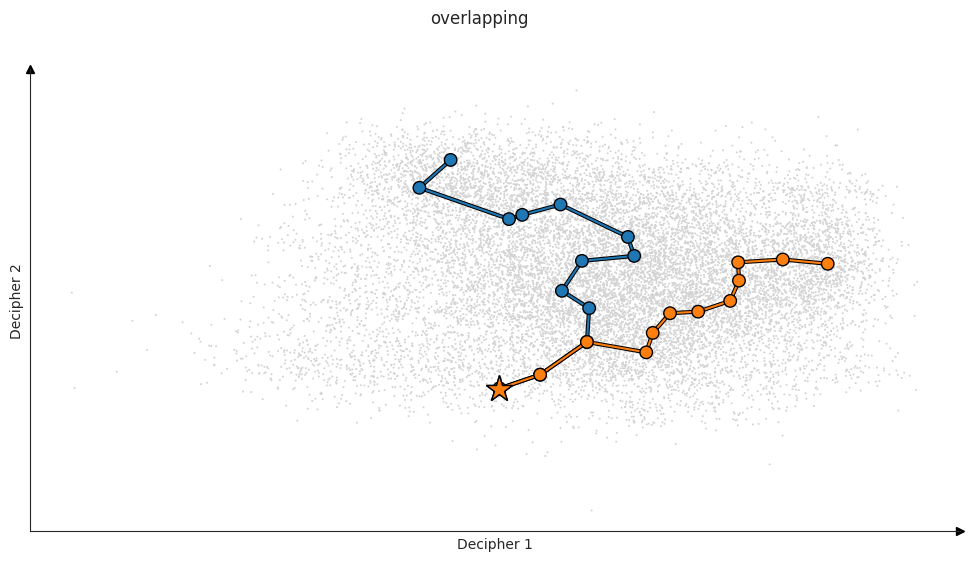

In [98]:
fig = dc.pl.trajectories(adata)
fig.set_size_inches(12, 6)
fig.suptitle("overlapping");

### Compute Decipher time

In [16]:
# computing with all trajectories
dc.tl.decipher_time(adata, n_neighbors = 30) # default n=10

2025-04-03 18:51:55,256 | INFO : Added `.obs['decipher_time']`: the decipher time of each cell.


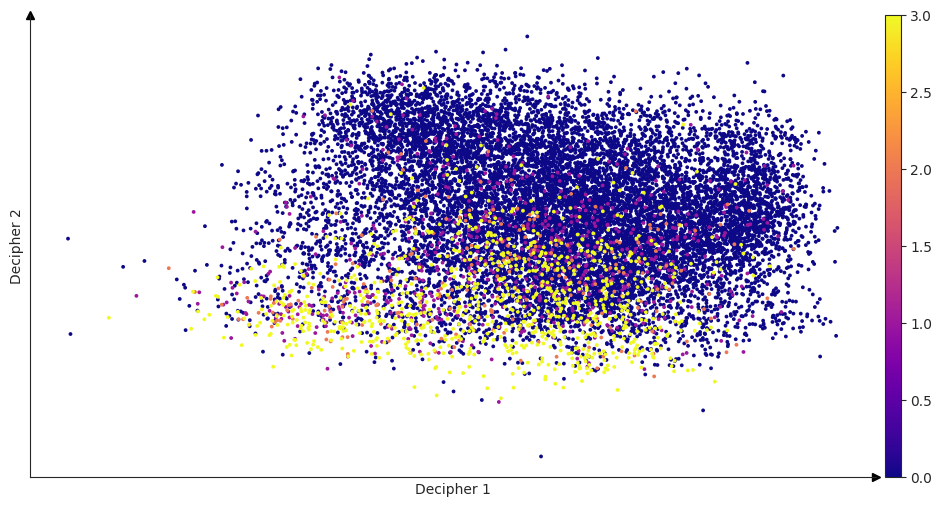

In [101]:
fig = dc.pl.decipher(adata, color = ['VCAN'], figsize = (12,6), s=30, vmax='p95',cmap='plasma')

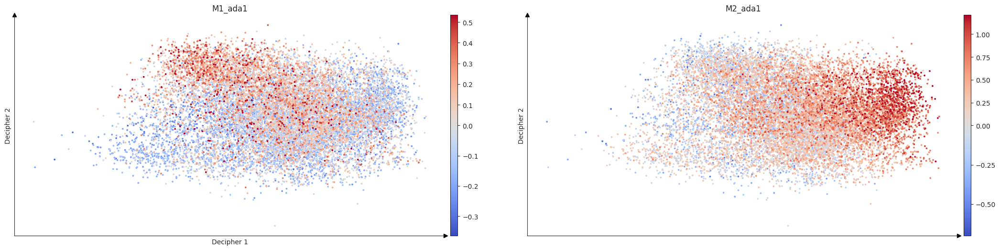

In [102]:
fig = dc.pl.decipher(adata, color = ['M1_ada1','M2_ada1'], figsize = (12,6), s=30, cmap='coolwarm', vcenter=0, title=['M1','M2'])

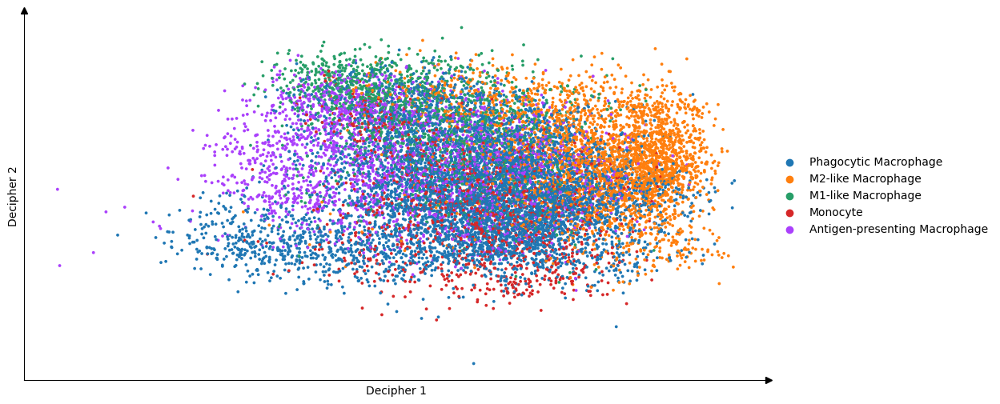

In [58]:
fig = dc.pl.decipher(adata, color = 'cell_type_fine', figsize = (12,6), s=30)

In [19]:
adata.write('myeloid_decipher_rotated_dpt_040225.h5ad')

# Interpret latent dimensions, decipher_time

## finalize trajectories and pseudotime

In [ ]:
def distributions_along_dpt(adata, obs, component = 'decipher_time', title=None, palette=None, legend=False, 
                            invert=False, remove_axes=False):
    df = adata.obs.copy()

    if obs == "cell_type_fine":
        pass
        # adata.obs[obs] = adata.obs[obs].astype("category") # necessary if subsampling/merging ads earlier
        # adata.obs[obs].cat.reorder_categories(['mutant','non-mutant'], inplace=True)
    
    fig, (ax1,ax2) = plt.subplots(2,1,sharex='col', figsize=(6,2))
    sns.histplot(data = df, x = component, hue = obs, multiple='stack', stat = 'probability', ax = ax1, legend = legend, palette = palette) # probability across each category
    sns.histplot(data = df, x = component, hue = obs, multiple='fill', ax = ax2, legend = False, palette = palette)
    ax1.set(ylabel=None); ax2.set(ylabel=None)
    if legend:
        sns.move_legend(ax1,'upper left', bbox_to_anchor=(1,1))
    if invert:
        ax1.invert_yaxis()

    if remove_axes:
        ax1.set(xticklabels=[], yticklabels=[], xlabel=None, ylabel=None)
        ax2.set(xticklabels=[], yticklabels=[], xlabel=None, ylabel=None)
    fig.suptitle(title)
    return fig # plt.show()

for obs in ['time','responder','tissue','cell_type_fine']:
    fig = distributions_along_dpt(adata, obs, legend=True)
    plt.show()

# Basis decomposition using decipher_time

In [ ]:
# adata = sc.read_h5ad('myeloid_decipher_rotated_dpt_032125.h5ad') # all patients
# adata = sc.read_h5ad('myeloid_decipher_rotated_dpt_040225.h5ad') # no F26 patient

## create reconstructed gene trajectories over decipher_time

In [20]:
# send trajectory points through decoders and sample to get distributions of gene expression
dc.tl.gene_patterns(adata)
adata.uns['decipher']['gene_patterns']['Monocyte-M1']['mean'].shape # decipher_time times x genes

V5


(213, 2027)

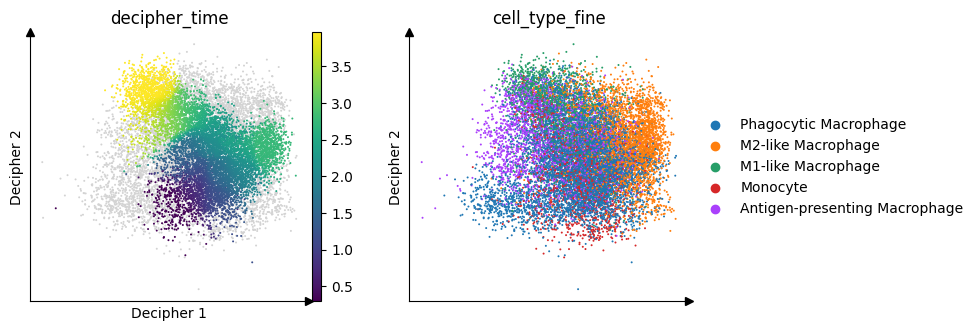

In [28]:
dc.pl.decipher(adata, ['decipher_time','cell_type_fine'])
cell_type_palette = {
    'Macrophages (M1-like)' : '#ff7f0e',
    'Macrophages (M2-like)' : '#279e68', 
    'Macrophages (antigen-pres.)' : '#d62728', 
    'Macrophages (phagocytic)' : '#8c564b', 
    'Monocytes' : '#e377c2',
}
plt.show()

### visualize gene trajectories and signatures over pseudotime

In [24]:
_ = dc.pl.gene_patterns(adata, 'VCAN', cell_type_key = 'cell_type_fine')
_ = dc.pl.gene_patterns(adata, 'CD40', cell_type_key = 'cell_type_fine')
_ = dc.pl.gene_patterns(adata, 'CD163', cell_type_key = 'cell_type_fine')

2025-04-03 18:53:14,032 | INFO : No palette provided for the cell types, using default.
2025-04-03 18:53:14,055 | INFO : No palette provided for the cell types, using default.
2025-04-03 18:53:14,069 | INFO : No palette provided for the cell types, using default.
2025-04-03 18:53:14,071 | INFO : No palette provided for the cell types, using default.
2025-04-03 18:53:14,083 | INFO : No palette provided for the cell types, using default.
2025-04-03 18:53:14,085 | INFO : No palette provided for the cell types, using default.


In [29]:
# other genes of interest?
_ = dc.pl.gene_patterns(adata, 'TNF', cell_type_key = 'cell_type_fine')

2025-04-03 18:53:42,754 | INFO : No palette provided for the cell types, using default.
2025-04-03 18:53:42,756 | INFO : No palette provided for the cell types, using default.


## train basis decomposition model

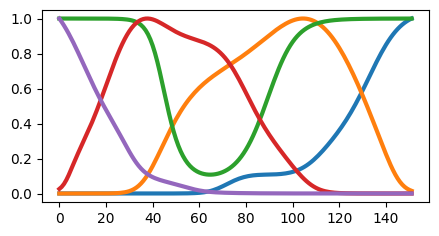

Loss: -763581.9 - Relative Error: 0.42%: 100%|███████████████████████████| 10000/10000 [11:15<00:00, 14.81it/s]


In [30]:
training_losses = dc.tl.basis_decomposition(adata, seed=0, plot_every_k_epochs=100) # =-2)

In [31]:
sns.lineplot(training_losses);

In [32]:
dc.tl.disruption_scores(adata)
adata.var[[c for c in adata.var if "decipher_disruption" in c]].sort_values(
    "decipher_disruption_combined", ascending=False
).head(10)

2025-04-03 19:05:03,131 | INFO : Added `.var['decipher_disruption_shape']`: shape disruption scores
2025-04-03 19:05:03,132 | INFO : Added `.var['decipher_disruption_scale']`: scale disruption scores
2025-04-03 19:05:03,132 | INFO : Added `.var['decipher_disruption_combined']`: combined disruption scores
2025-04-03 19:05:03,134 | INFO : Added `.uns['decipher']['disruption_scores']`: disruption scores
2025-04-03 19:05:03,135 | INFO : Added `.uns['decipher']['disruption_scores_samples']`: disruption scores probabilistic samples


,decipher_disruption_shape,decipher_disruption_scale,decipher_disruption_combined
CD52,0.436222,0.822199,11.537895
MMP7,0.369065,0.585821,10.804148
ITGA3,0.284750,0.478344,10.447418
LYVE1,0.866392,1.903201,10.432077
SCN9A,1.109593,2.718828,10.404965
TIMP3,0.405186,0.819869,10.205716
IFNG,0.664863,1.212746,10.188328
HTR2A,0.265235,0.444597,10.182800
CHI3L1,0.885893,1.767680,10.045418
GZMB,0.635622,1.090388,9.906960


In [ ]:
# adata.write('myeloid_decipher_rotated_dpt_basis_decomp_032125.h5ad') # includes all patients
adata.write('myeloid_decipher_rotated_dpt_basis_decomp_040225.h5ad') # no F26 patient

# Interpret basis decomposition

In [ ]:
# adata = sc.read_h5ad('myeloid_decipher_rotated_dpt_basis_decomp_032125.h5ad') # includes all patients
# adata = sc.read_h5ad('myeloid_decipher_rotated_dpt_basis_decomp_040225.h5ad') # no F26 patient

## Examine disruption scores

In [ ]:
# dc.tl.disruption_scores(adata)
disruption_score_df = adata.var[[c for c in adata.var if "decipher_disruption" in c]].sort_values(
    "decipher_disruption_combined", ascending=False)
print(disruption_score_df.shape)
disruption_score_df.head()

In [ ]:
adata.uns['decipher']['basis_decomposition']['pattern_names']# .keys()

In [ ]:
print('most disrupted genes, sorted by shape disruption:')
disruption_score_df.sort_values('decipher_disruption_shape', ascending=False, inplace=True)
dc.pl.disruption_scores(adata, gene_names = disruption_score_df.iloc[:100,0].index, figsize=(18,9), sort_by='decipher_disruption_shape')
ticks = plt.xticks(rotation=90)[1]

In [ ]:
print('most disrupted genes, sorted by combined disruption:')
disruption_score_df.sort_values('decipher_disruption_combined', ascending=False, inplace=True)
dc.pl.disruption_scores(adata, gene_names = disruption_score_df.iloc[:100,0].index, figsize=(18,9), sort_by='decipher_disruption_combined')
ticks = plt.xticks(rotation=90)[1]

In [ ]:
print('least disrupted genes, sorted by shape disruption:')
disruption_score_df.sort_values('decipher_disruption_shape', ascending=True, inplace=True)
dc.pl.disruption_scores(adata, gene_names = disruption_score_df.iloc[:100,0].index, figsize=(18,9),sort_by='decipher_disruption_shape')
ticks = plt.xticks(rotation=90)[1]

In [ ]:
print('least disrupted genes, sorted by combined disruption:')
disruption_score_df.sort_values('decipher_disruption_combined', ascending=True, inplace=True)
dc.pl.disruption_scores(adata, gene_names = disruption_score_df.iloc[:100,0].index, figsize=(18,9),sort_by='decipher_disruption_combined')
ticks = plt.xticks(rotation=90)[1]

In [ ]:
_ = dc.pl.gene_patterns(adata, 'VCAN', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'SOX5', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'FOS', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'RHOB', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'MDM2', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'INSR', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'LDLR', cell_type_key = 'cell_type_fine', palette = cell_type_palette)
_ = dc.pl.gene_patterns(adata, 'IDO1', cell_type_key = 'cell_type_fine', palette = cell_type_palette)

In [ ]:
dc.pl.gene_patterns(adata, ['B2M'], cell_type_key = 'cell_type_fine', palette = cell_type_palette)
dc.pl.gene_patterns(adata, ['CD58'], cell_type_key = 'cell_type_fine', palette = cell_type_palette)

# Define M1-like and M2-like divergence score signature and heatmap

In [ ]:
# adata = sc.read_h5ad('myeloid_decipher_rotated_dpt_basis_decomp_032125.h5ad') # includes all patients
# adata = sc.read_h5ad('myeloid_decipher_rotated_dpt_basis_decomp_040225.h5ad') # no F26 patient

In [118]:
disruption_score_df = adata.var[[c for c in adata.var if "decipher_disruption" in c]].sort_values(
    "decipher_disruption_combined", ascending=False)
disruption_score_df.head()

,decipher_disruption_shape,decipher_disruption_scale,decipher_disruption_combined
CD52,0.436222,0.822199,11.537895
MMP7,0.369065,0.585821,10.804148
ITGA3,0.284750,0.478344,10.447418
LYVE1,0.866392,1.903201,10.432077
SCN9A,1.109593,2.718828,10.404965


In [119]:
# calculate signed disruption (M2 vs. M1, at end of M1 trajectory)
genes = adata.var_names
end_time_i = np.argmax(adata.uns['decipher']['gene_patterns']['Monocyte-M2']['times'])
m2 = adata.uns['decipher']['gene_patterns']['Monocyte-M2']['mean'][end_time_i]
m1 = adata.uns['decipher']['gene_patterns']['Monocyte-M1']['mean'][end_time_i]
gene_differences = pd.DataFrame(index = genes)
gene_differences['M2'] = m2
gene_differences['M1'] = m1
gene_differences['difference'] = gene_differences['M2'] - gene_differences['M1']
gene_differences['difference_sign'] = np.sign(gene_differences['difference'])
gene_differences = gene_differences.loc[disruption_score_df.index,:]
gene_differences.head(5)

,M2,M1,difference,difference_sign
CD52,0.061610,0.889764,-0.828153,-1.0
MMP7,0.001287,0.006422,-0.005135,-1.0
ITGA3,0.032799,0.061286,-0.028487,-1.0
LYVE1,8.833612,0.035406,8.798207,1.0
SCN9A,15.549553,0.159002,15.390551,1.0


In [120]:
disruption_score_df['sign (M2-M1)'] = gene_differences['difference_sign']
disruption_score_df['M2_v_M1'] = disruption_score_df['sign (M2-M1)'].replace({
    -1.0:'M1 > M2',
    1.0 :'M2 > M1'
})
disruption_score_df.head()

,decipher_disruption_shape,decipher_disruption_scale,decipher_disruption_combined,sign (M2-M1),M2_v_M1
CD52,0.436222,0.822199,11.537895,-1.0,M1 > M2
MMP7,0.369065,0.585821,10.804148,-1.0,M1 > M2
ITGA3,0.284750,0.478344,10.447418,-1.0,M1 > M2
LYVE1,0.866392,1.903201,10.432077,1.0,M2 > M1
SCN9A,1.109593,2.718828,10.404965,1.0,M2 > M1


In [121]:
# choose only M2 upregulated genes, and visualize top 100
M2_upregulated = disruption_score_df.loc[disruption_score_df['M2_v_M1'] == 'M2 > M1',:]
M2_upregulated.sort_values('decipher_disruption_shape', ascending=False, inplace=True) # sort by shape
# M2_upregulated.sort_values('decipher_disruption_combined', ascending=False, inplace=True) # sort by combined (shape and scale)
# pd.DataFrame(M2_upregulated.index[:100]).to_csv('M2_like_disruption_sig_032125.csv')
pd.DataFrame(M2_upregulated.index[:100]).to_csv('M2_like_disruption_sig_040225.csv')

In [122]:
# choose only M1 upregulated genes, and visualize top 100
M1_upregulated = disruption_score_df.loc[disruption_score_df['M2_v_M1'] == 'M1 > M2',:]
M1_upregulated.sort_values('decipher_disruption_shape', ascending=False, inplace=True) # sort by shape
# M1_upregulated.sort_values('decipher_disruption_combined', ascending=False, inplace=True) # sort by combined  (shape and scale)
# pd.DataFrame(M1_upregulated.index[:100]).to_csv('M1_like_disruption_sig_032125.csv')
pd.DataFrame(M1_upregulated.index[:100]).to_csv('M1_like_disruption_sig_040225.csv')

## heatmap (see generate publication code)

In [123]:
# limit to top 100
M2_upregulated = M2_upregulated.iloc[:100,:]
M1_upregulated = M1_upregulated.iloc[:100,:]

In [124]:
# heatmap of disruption score
heatmap = pd.concat([M1_upregulated,M2_upregulated], axis=0)
heatmap['disruption_shape'] = heatmap['decipher_disruption_shape'] * -1 * heatmap['sign (M2-M1)']
heatmap['disruption_combined'] = heatmap['decipher_disruption_combined'] * -1 * heatmap['sign (M2-M1)']
heatmap['gene'] = heatmap.index
heatmap['color'] = 'grey'
heatmap.loc[heatmap['gene'].isin([
    "AKR1A1", "ALDH1A1", "APOC1", "APOE", "APOL3", "AXL", "B2M", "C1orf54", 
    "C1QA", "C1QB", "C1QC", "C2", "CD38", "CD4", "CD74", "CIITA", "CLIC2", 
    "CMKLR1", "CTSC", "CXCL9", "EBI3", "ENPP2", "EPB41L2", "FAM26F", "FGD2", 
    "GBP4", "GIMAP5", "GM2A", "HAPLN3", "HLA-DMA", "HLA-DMB", "HLA-DOA", 
    "HLA-DPA1", "HLA-DPB1", "HLA-DPB2", "HLA-DQA1", "HLA-DQB1", "HLA-DQB2", 
    "HLA-DRA", "HLA-DRB1", "HLA-DRB5", "LGALS3BP", "LILRB4", "MS4A6A", 
    "NAGK", "NR1H3", "P2RY12", "P2RY6", "PDCD1LG2", "PLA2G2D", "PLEKHO1", 
    "PPA1", "PRDX1", "PSME2", "RARRES3", "SDC3", "SERPING1", "SLAMF7", 
    "SLAMF8", "TIFAB", "TMSB4X", "TRAFD1", "UBD", "VOPP1"
]),'color'] = 'green' # hot macrophage signature
heatmap.loc[heatmap['gene'].isin(myeloid_signatures['M1_ada']),'color'] = 'red'
heatmap.loc[heatmap['gene'].isin(myeloid_signatures['M2_ada']),'color'] = 'blue'
heatmap = heatmap.sort_values('disruption_shape', ascending=False)

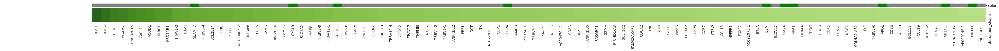

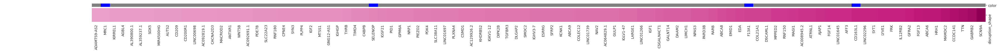

In [125]:
sns.set_style("white")
use = heatmap[:100] # split into 2 rows
cm = sns.clustermap(use[['disruption_shape']].T, col_colors = use['color'], row_cluster=False, col_cluster=False, center=0, cmap = 'PiYG', figsize=(50,1), cbar_pos=None, dendrogram_ratio=(0,0), colors_ratio=0.2, xticklabels=1)
# plt.savefig('fig/S5- Immune T Cells Myeloid B Cells/myeloid_disruption_score_heatmap_1.pdf', format='pdf', dpi=300, transparent=True, bbox_inches='tight')
use = heatmap[100:] # split into 2 rows
cm = sns.clustermap(use[['disruption_shape']].T, col_colors = use['color'], row_cluster=False, col_cluster=False, center=0, cmap = 'PiYG', figsize=(50,1), cbar_pos=None, dendrogram_ratio=(0,0), colors_ratio=0.2, xticklabels=1)
# plt.savefig('fig/S5- Immune T Cells Myeloid B Cells/myeloid_disruption_score_heatmap_2.pdf', format='pdf', dpi=300, transparent=True, bbox_inches='tight')

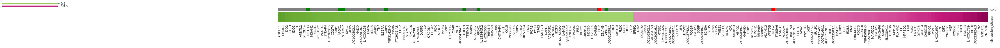

In [80]:
# for legend
cm = sns.clustermap(heatmap[['disruption_shape']].T, col_colors = heatmap['color'], row_cluster=False, col_cluster=False, center=0, cmap = 'PiYG', figsize=(50,1), dendrogram_ratio=(0.1,0.1), colors_ratio=0.2, xticklabels=1)
# plt.savefig('fig/S5- Immune T Cells Myeloid B Cells/myeloid_disruption_score_heatmap_cmap.pdf', format='pdf', dpi=300, transparent=True, bbox_inches='tight')

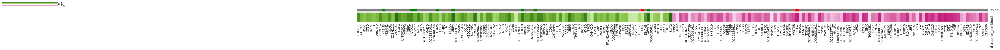

In [81]:
# visualizing combined (shape * scale) vs. shape
cm = sns.clustermap(heatmap[['disruption_combined']].T, col_colors = heatmap['color'], row_cluster=False, col_cluster=False, center=0, cmap = 'PiYG', figsize=(50,1), colors_ratio=0.2, xticklabels=1)
# plt.savefig('fig/S5- Immune T Cells Myeloid B Cells/myeloid_disruption_score_heatmap.pdf', format='pdf', dpi=300, transparent=True, bbox_inches='tight')

## examine shift in covariates along each trajectory

In [ ]:
m1_clusters = adata.uns['decipher']['trajectories']['Monocyte-M1']['cluster_ids']
m2_clusters = adata.uns['decipher']['trajectories']['Monocyte-M2']['cluster_ids']
dc.pl.decipher(adata[adata.obs['decipher_clusters'].isin(set(m1_clusters) | set(m2_clusters))], color='decipher_time', figsize=(12,6),s=20, title='together');
dc.pl.decipher(adata[adata.obs['decipher_clusters'].isin(set(m1_clusters))], color='decipher_time', figsize=(12,6),s=20, title='M1 only');
dc.pl.decipher(adata[adata.obs['decipher_clusters'].isin(set(m2_clusters))], color='decipher_time', figsize=(12,6),s=20, title='M2 only');

In [ ]:
def distributions_along_dpt(adata, obs, component = 'decipher_time', title=None, palette=None, legend=False, 
                            invert=False, remove_axes=False):
    df = adata.obs.copy()

    if obs == "cell_type_fine":
        pass
        # adata.obs[obs] = adata.obs[obs].astype("category") # necessary if subsampling/merging ads earlier
        # adata.obs[obs].cat.reorder_categories(['mutant','non-mutant'], inplace=True)
    
    fig, (ax1,ax2) = plt.subplots(2,1,sharex='col', figsize=(6,2))
    sns.histplot(data = df, x = component, hue = obs, multiple='stack', stat = 'probability', ax = ax1, legend = legend, palette = palette) # probability across each category
    sns.histplot(data = df, x = component, hue = obs, multiple='fill', ax = ax2, legend = False, palette = palette)
    ax1.set(ylabel=None); ax2.set(ylabel=None)
    if legend:
        sns.move_legend(ax1,'upper left', bbox_to_anchor=(1,1))
    if invert:
        ax1.invert_yaxis()

    if remove_axes:
        ax1.set(xticklabels=[], yticklabels=[], xlabel=None, ylabel=None)
        ax2.set(xticklabels=[], yticklabels=[], xlabel=None, ylabel=None)
    fig.suptitle(title)
    return fig # plt.show()

for obs in ['time','responder','tissue','cell_type_fine']:
    palette = None
    if obs == 'bucketed_days_to/from_ICI_start':
        palette = 'plasma'
    fig = distributions_along_dpt(adata, obs, legend=True, palette = palette)
    plt.show()

In [ ]:
m1 = adata[adata.obs['decipher_clusters'].isin(set(m1_clusters))]
for obs in ['time','responder','tissue','cell_type_fine']:
    palette = None
    fig = distributions_along_dpt(m1, obs, legend=True, palette=palette)
    plt.show()

In [ ]:
m2 = adata[adata.obs['decipher_clusters'].isin(set(m2_clusters))]
for obs in ['time','responder','tissue','cell_type_fine']:
    palette = None
    fig = distributions_along_dpt(m2, obs, legend=True, palette = palette)
    plt.show()